50, 320 ,32 ,yolov5s ,500*375 ,13690 ,3422,17112

In [ ]:
TRAIN = True
# Number of epochs to train for.
EPOCHS = 25

In [ ]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np

np.random.seed(42)

In [ ]:
!unzip '/content/drive/MyDrive/OgPCContents/Project/Pascal VOC 2012.v1-raw.yolov5pytorch.zip'

Streaming output truncated to the last 5000 lines.
 extracting: train/labels/2008_001312_jpg.rf.e1a588f85f3fe5fc2583d05274517591.txt  
 extracting: train/labels/2011_002853_jpg.rf.e1adc0f08261ff95c62f248346a0ce6c.txt  
 extracting: train/labels/2010_000392_jpg.rf.e1be4b0f59951d6d1c2a415b0a6cb494.txt  
 extracting: train/labels/2008_006696_jpg.rf.e1af8b35405b0e49baffda1f3f9064b7.txt  
 extracting: train/labels/2009_002193_jpg.rf.e1c5b025e045ebb1f244e280d363861a.txt  
 extracting: train/labels/2009_001707_jpg.rf.e1cb218fc7e2cdc591c3dc32392aa75e.txt  
 extracting: train/labels/2011_000203_jpg.rf.e1cefbd4d0fd92b2162256acdd7b00c4.txt  
 extracting: train/labels/2007_009649_jpg.rf.e1d6620b50f73a38fbc41225c8acea1f.txt  
 extracting: train/labels/2008_004599_jpg.rf.e1d98a39440ef6e401062e107c329c72.txt  
 extracting: train/labels/2010_003169_jpg.rf.e1db1e98b1d8d5f23180fa09288680a0.txt  
 extracting: train/labels/2010_006263_jpg.rf.e1dbf738331c9405f0fc046d885ce043.txt  
 extracting: train/labels

In [ ]:
class_names = ['aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus', 'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike', 'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tvmonitor']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

In [ ]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [ ]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin
        
        class_name = class_names[int(labels[box_num])]
        # class_name = class_names[labels]
        
        cv2.rectangle(
            image, 
            (xmin, ymin), (xmax, ymax),
            color=colors[class_names.index(class_name)],
            thickness=2
        ) 

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))
        
        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(
            class_name, 
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image, 
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image, 
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

In [ ]:
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()
    
    num_images = len(all_training_images)
    print('num_images==>',num_images)
    print('num_labels==>',len(all_training_labels))
    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        print('j==>',j)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line.split(' ')[0]
                print('label==>',label)
                print('line==>',label_line)
                bbox_string = label_line[2:]
                print('split==>',bbox_string.split(' '))
                print('count==>',bbox_string.split(' ').count(''))
                if bbox_string.split(' ').count('') > 0:
                  bbox_string=bbox_string.split(' ')
                  bbox_string.remove('')
                else:
                  bbox_string=bbox_string.split(' ')
                x_c, y_c, w, h = bbox_string
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

num_images==> 13690
num_labels==> 13690
j==> 7006
label==> 6
line==> 6 0.537 0.489159891598916 0.902 0.94579945799458
split==> ['0.537', '0.489159891598916', '0.902', '0.94579945799458']
count==> 0
j==> 9524
label==> 6
line==> 6 0.253 0.49066666666666664 0.354 0.256

split==> ['0.253', '0.49066666666666664', '0.354', '0.256\n']
count==> 0
label==> 14
line==> 14 0.466 0.488 0.056 0.20266666666666666

split==> ['', '0.466', '0.488', '0.056', '0.20266666666666666\n']
count==> 1
label==> 14
line==> 14 0.933 0.472 0.038 0.13333333333333333
split==> ['', '0.933', '0.472', '0.038', '0.13333333333333333']
count==> 1
j==> 9395
label==> 5
line==> 5 0.444 0.4693333333333333 0.848 0.6026666666666667

split==> ['0.444', '0.4693333333333333', '0.848', '0.6026666666666667\n']
count==> 0
label==> 14
line==> 14 0.699 0.42533333333333334 0.074 0.088
split==> ['', '0.699', '0.42533333333333334', '0.074', '0.088']
count==> 1
j==> 12851
label==> 14
line==> 14 0.538 0.5373333333333333 0.324 0.84
split==> ['

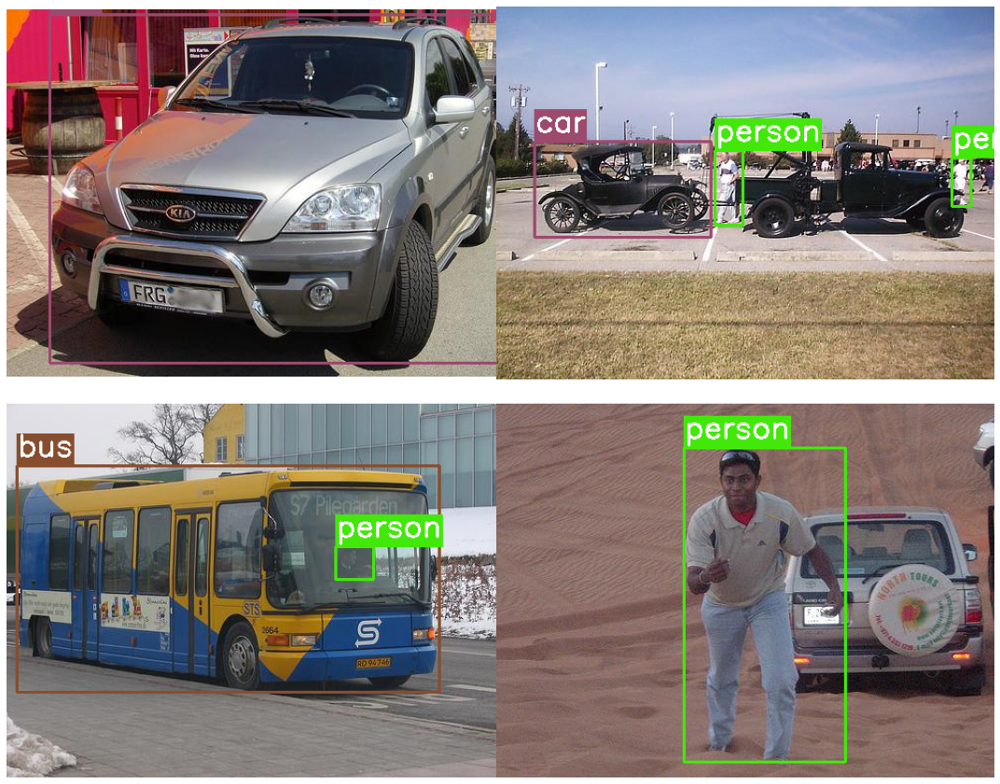

In [ ]:
# Visualize a few training images.
plot(
    image_paths='train/images/*', 
    label_paths='train/labels/*',
    num_samples=4,
)

In [ ]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

In [ ]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir runs/train

In [ ]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 15287, done.
remote: Counting objects: 100% (51/51), done.
remote: Compressing objects: 100% (44/44), done.
remote: Total 15287 (delta 21), reused 28 (delta 7), pack-reused 15236
Receiving objects: 100% (15287/15287), 14.24 MiB | 24.34 MiB/s, done.
Resolving deltas: 100% (10469/10469), done.


In [ ]:
%cd yolov5/
!pwd

/content/yolov5
/content/yolov5


In [ ]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 KB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 32.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 7.0 MB/s eta 0:00:00
  Attempting uninstall: setuptools
    Found existing installation: setuptools 57.4.0
    Uninstalling setuptools-57.4.0:
      Successfully uninstalled setuptools-57.4.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
ipython 7.9.0 requires jedi>=0.10, which is not installed.
cvxpy 1.2.3 requires setuptools<=64.0.2, but you have setuptools 67.4.0 which is incompatible.


In [ ]:
monitor_tensorboard()

<IPython.core.display.Javascript object>

In [ ]:
# RES_DIR = set_res_dir()

Current number of result directories: 0
results_1


In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5s.pt \
    --img 320 --epochs {50} --batch-size 32 --name {RES_DIR}

Current number of result directories: 5
results_6
train: weights=yolov5s.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=32, imgsz=320, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_6, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-116-g5c91dae Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor

In [ ]:
# Function to show validation predictions saved during training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"runs/train/{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

In [ ]:
show_valid_results(RES_DIR)

In [ ]:
def download_file(url, save_name):
    url = url
    if not os.path.exists(save_name):
        file = requests.get(url)
        open(save_name, 'wb').write(file.content)
    else: 
        print('File already present, skipping download...')

In [ ]:
download_file('https://learnopencv.s3.us-west-2.amazonaws.com/yolov5_inference_data.zip',
              'inference_data.zip')
if not os.path.exists('inference_images'):
    !unzip -q "inference_data.zip"
else:
    print('Dataset already present')

In [ ]:
# Helper function for inference on images.
def inference(RES_DIR, data_path):
    # Directory to store inference results.
    infer_dir_count = len(glob.glob('runs/detect/*'))
    print(f"Current number of inference detection directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inference on images.
    !python detect.py --weights /content/drive/MyDrive/OgPCContents/Project/Model_50/best.pt \
    --source {data_path} --name {INFER_DIR}
    return INFER_DIR

In [ ]:
def visualize(INFER_DIR):
# Visualize inference images.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

In [ ]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, 'inference_images')

Current number of inference detection directories: 0
inference_1
detect: weights=['/content/drive/MyDrive/OgPCContents/Project/Model_50/best.pt'], source=inference_images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_1, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-116-g5c91dae Python-3.8.10 torch-1.13.1+cu116 CPU

Fusing layers... 
Model summary: 157 layers, 7064065 parameters, 0 gradients, 15.9 GFLOPs
image 1/4 /content/yolov5/inference_images/image_1.jpg: 448x640 6 cars, 326.2ms
image 2/4 /content/yolov5/inference_images/image_2.jpg: 416x640 3 cars, 9 persons, 279.2ms
image 3/4 /content/yolov5/inference_images/image_3.jpg: 448x640 2 buss, 4 persons, 302.0ms
image 4/

['runs/detect/inference_1/image_2.jpg', 'runs/detect/inference_1/image_4.jpg', 'runs/detect/inference_1/image_1.jpg', 'runs/detect/inference_1/image_3.jpg']


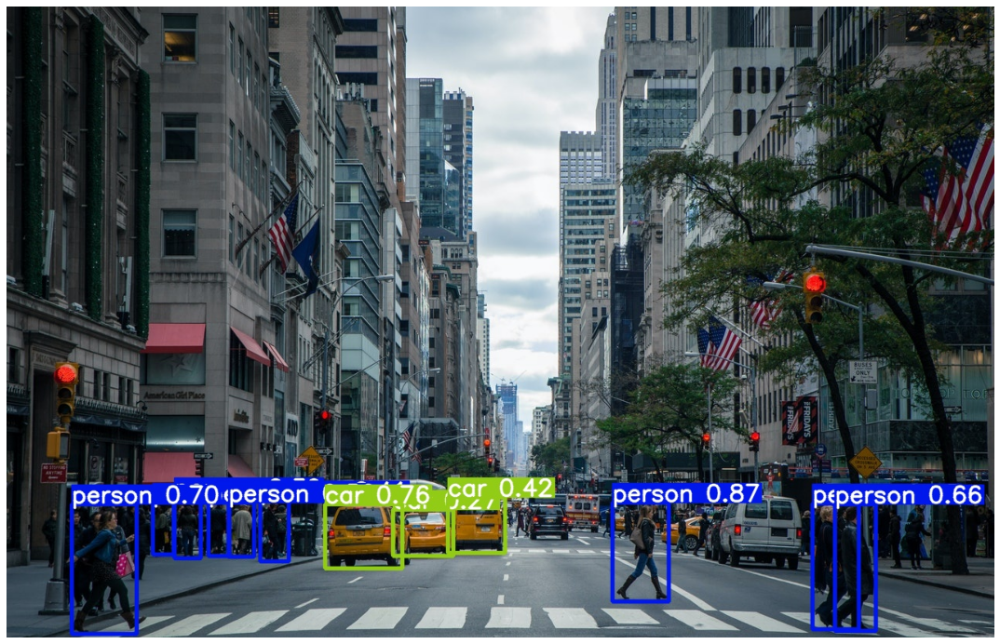

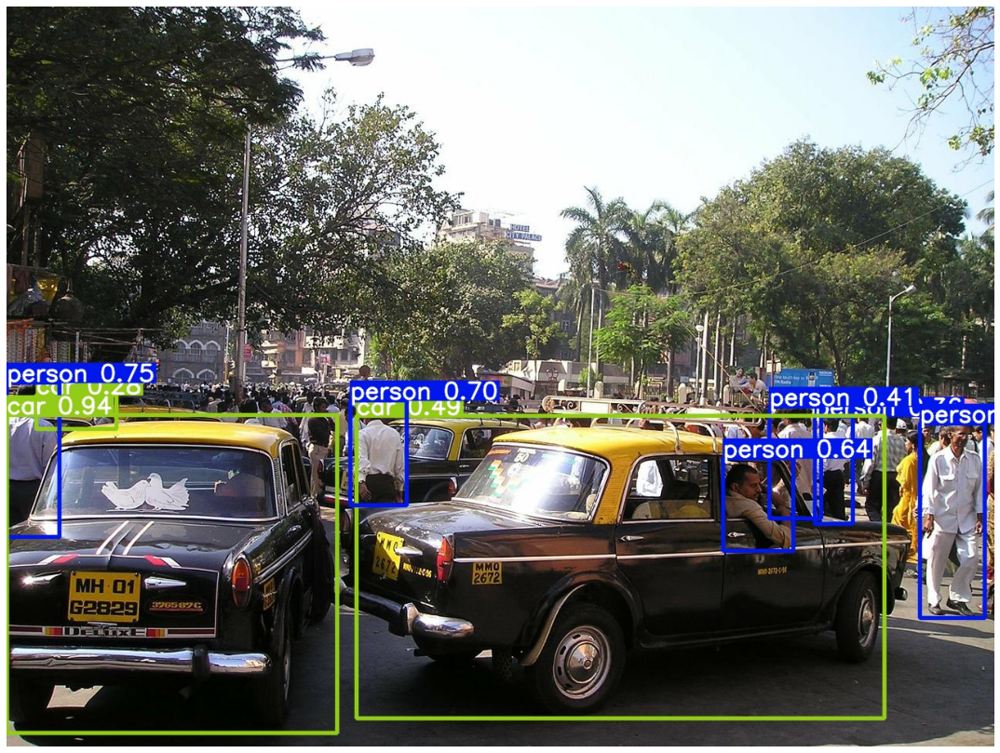

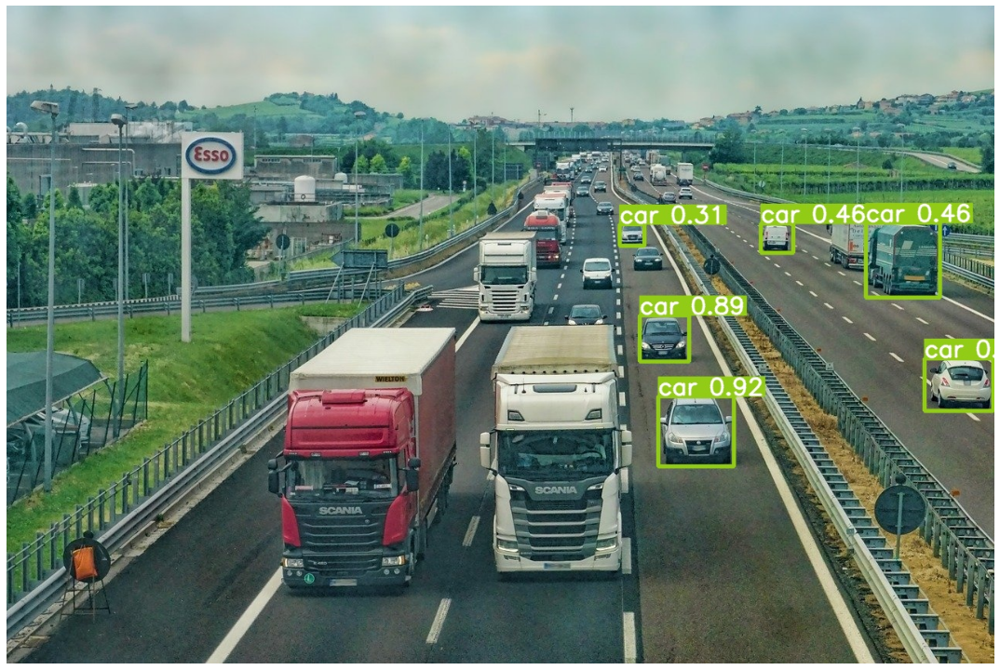

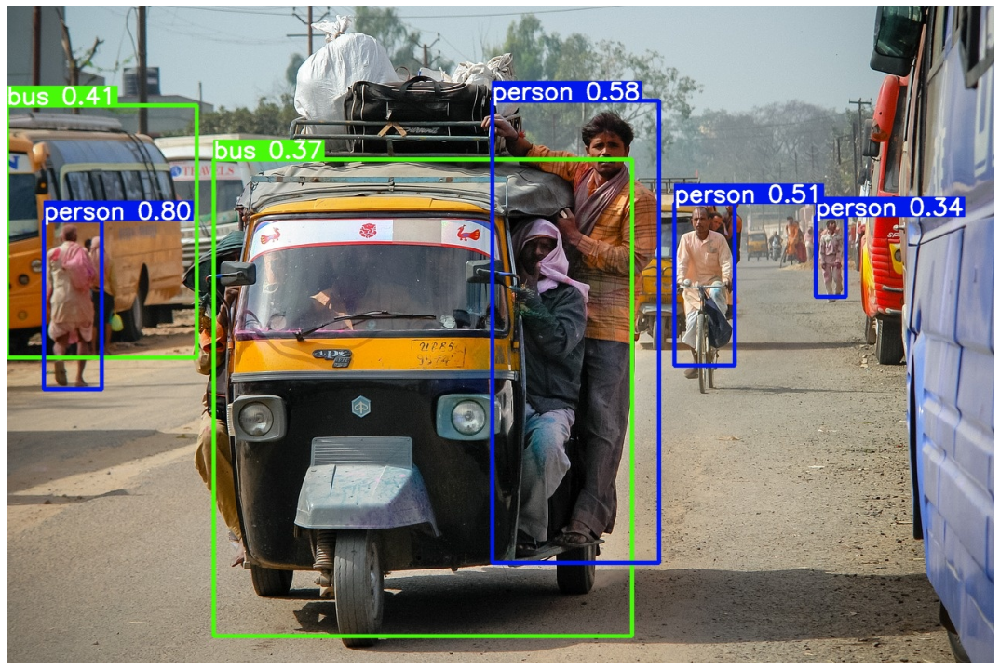

In [ ]:
visualize(IMAGE_INFER_DIR)